## ***Required Imports and Data Loading***

---



---



In [20]:
#installing xgboost library through pip to use XGBoost Classifiers
!pip install xgboost

Defaulting to user installation because normal site-packages is not writeable


In [18]:
#importing for data handling
import pandas as pd
import numpy as np

#importing to get training time
import time

#importing for plotting graphs
import matplotlib.pyplot as plt

import seaborn as sns

#importing for Evaluation Metric
from sklearn.metrics import f1_score, recall_score, precision_score
from sklearn.metrics import PrecisionRecallDisplay
from sklearn.metrics import auc
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

#imporing for data pre_processing
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.model_selection import train_test_split as split

#importing models from sklearn
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier

#importing for upscaling
from imblearn.over_sampling import SMOTE

#importing to supress warnings
import warnings

#importing to load and dump models
import pickle

In [19]:
#to supress an sns error of distplot function
warnings.filterwarnings('ignore')

In [20]:
#Loading the data
# data = pd.read_csv('/content/drive/MyDrive/creditcard.csv')
data = pd.read_csv('creditcard.csv')

#Storing columns in list for a possible later use
columns = ['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class']


# The classes are heavily skewed we need to solve this issue later.
print('Percentage of non-fraud transactions :', data['Class'].value_counts()[0]/len(data) * 100, '% of all the transactions.')
print('Percentage of fraud transactions :', data['Class'].value_counts()[1]/len(data) * 100, '% of all the transactions.')

Percentage of non-fraud transactions : 99.82725143693798 % of all the transactions.
Percentage of fraud transactions : 0.1727485630620034 % of all the transactions.


In [21]:
#separating classes and features
data_y = data['Class']
data_x = data.drop(['Class'], axis=1)

In [73]:
#Checking for null values
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

*There are no null values in any column of the data.*

## ***Correlation Matrix***

In [75]:
#printing percentage of total variance covered by the column variance
data_x_v = data_x[columns[1: 29]]
data_x_v.var()*100/data_x_v.var().sum()

V1     12.483757
V2      8.872945
V3      7.480934
V4      6.523148
V5      6.199045
V6      5.775592
V7      4.979852
V8      4.641696
V9      3.927497
V10     3.857867
V11     3.390148
V12     3.248758
V13     3.223271
V14     2.990076
V15     2.726173
V16     2.498448
V17     2.347316
V18     2.286030
V19     2.156271
V20     1.933907
V21     1.755591
V22     1.713671
V23     1.268881
V24     1.193577
V25     0.884199
V26     0.756684
V27     0.530131
V28     0.354534
dtype: float64

# ***Pipeline***

---



---



In [57]:
class fraud_detector():
    '''A class for visualization and processing of data and train, test, and evaluation of models.
    
    -data_x and data_y are required if visualization functions are to be used.
    
    Parameters
    ----------
    data_x : panda Datafraame object having minimum 1 column, default=None
             The data input feature samples.
             Required for data visualization.
             
    data_y : panda Datafraame object having minimum 1 column, default=None
             The data input class samples.
             Required for data visualization.
             
    If data_x and data_y are not given, visualization functions will raise errors.
        
    '''

    def __init__(self, data_x=None, data_y=None):
        self.data_x = data_x
        self.data_y = data_y
        
        self.train_x = None
        self.train_y = None
        self.test_x = None
        self.test_y = None
        
        return None
    

    def scatter_plot(self, column=[]):
        """Plots the scatter plot using seaborn.
        
        -Plots the plots automatically.
        -If data_x and data_y are not given while creating class instance, this function should not be used, will raise error.
        
        Parameters
        ----------
        column : list, deafult=[]
                 The columns to be used for plotting the scatter plot:
                 
                 - If [], the plots scatter plots of all the features in data_x against each other taking data_y as hue using seaborn.pairplot
                 - If list having length=2, plots the scatter plot of the specified columns taking them on x-axis and y-axis and hue as data_y usding seaborn.scatterplot()
        
        Returns
        -------
        None
        """
        
        if len(column) == 2:
            sns.scatterplot(x = self.data_x[column[0]], y = self.data_x[column[1]], hue = self.data_y)

        else:
            data = self.data_x.copy()
            data['Class'] = self.data_y
            sns.pairplot(data=data, hue='Class')
        
        return None

        
    def plot_column_distributions(self, columns = False):
         """Plots the scatter plot using seaborn.
         
         -Plots the plots automatically.
         -If data_x and data_y are not given while creating class instance, this function should not be used, will raise error.
        
        Parameters
        ----------
        columns : list, deafult=False
                  The columns of which kernel density estimate graph has to be plotted (using seaborn.distplot())
                 
                 - If [], the plots scatter plots of all the features in data_x against each other taking data_y as hue using seaborn.pairplot
                 - If list having length=2, plots the scatter plot of the specified columns taking them on x-axis and y-axis and hue as data_y usding seaborn.scatterplot()
        
        Returns
        -------
        None
        """

        if columns:
            columns = columns

        else:
            columns = self.data_x.columns

        num_col = len(columns)
        plt.figure(figsize=(12,30*5))
        count = 1

        for i in columns:

            ax = plt.subplot(30, 1, count)
            sns.distplot(self.data_x[i][self.data_y == 1], bins=50)
            sns.distplot(self.data_x[i][self.data_y == 0], bins=50)
            ax.set_xlabel = ''
            ax.set_ylabel = ''
            ax.set_title('Histogram and distribution of feature ' + i)
            # ax.legend()
            count+=1
            
        plt.show()


        return None


    def train_test_split(self, split_val=0):
        """Splits given data into train and test data.
        
         -If data_x and data_y are not given while creating class instance, this function should not be used, will raise error.
         -Creates train and test datas inside the instance and stores them
         
        Parameters
        ----------
        split_val : {float, 0 , 1} any value between 0 and 1
                    The train_size when splitting the data
                    
                    -If 0, whole data is used as test data
                    If 1, whole data is used as train data
                    
        Returns
        -------
        (self.train_x, self.train_y, self.test_x, self.test_y) : tuple
            The train_x, train_y, test_x, test_y created when the function is called.
        """
        self.split_val = split_val

        if (self.split_val == 0):
            self.test_x = self.data_x
            self.test_y = self.data_y
        
        elif (self.split_val == 1):
            self.train_x = self.data_x
            self.train_y = self.data_y

        else:
            self.train_x, self.test_x, self.train_y, self.test_y = split(self.data_x, self.data_y, train_size=self.split_val)

        return (self.train_x, self.train_y, self.test_x, self.test_y)


    def scaler(self, type='standard'):
        """Scales the data according to the type given.
        
         -If data_x and data_y are not given while creating class instance, this function should not be used, will raise error.
        
        Parameters
        ----------
            type : {'standard', 'minimax', default='standard'}
                   The type of scaling to be applied
                   
        Returns
        -------
        (self.data_x, self.data_y) : tuple
            The scaled data with the respective class labels.
        """
        if type == 'standard':
            for column in self.data_x.columns:
                self.data_x[column] = StandardScaler().fit_transform(np.array(self.data_x[column]).reshape(-1,1))

        else:
            for column in self.data_x.columns[1:29]:
                self.data_x[column] = MinMaxScaler(feature_range=(-1, 1)).fit_transform(np.array(self.data_x[column]).reshape(-1,1))

            for column in ['Time', 'Amount']:
                self.data_x[column] = MinMaxScaler(feature_range=(0, 1)).fit_transform(np.array(self.data_x[column]).reshape(-1,1))
                
        returns (self.data_x, self.data_y)


    def _call_smote(self):
        """Applies SMOTE upscaling algorithm.
        
         -Need to do train test split before calling SMOTE so as to create train test split.
         
        Parameters
        ----------
        None
        
        Returns
        -------
        self.smote : SMOTE() object instance
            The SMOTE() object instance fitted with the train data.
        """

        self.smote = SMOTE(random_state=42,sampling_strategy=0.01)
        self.train_x, self.train_y = self.smote.fit_resample(self.train_x, self.train_y)

        return self.smote


    def tranform_data(self, scale=False, oversample=False, remove_columns=[]):
        """Transforming Data by scaling and oversampling
        Need to send data_x and data_y while creating instance before calling transform_data so as to create data_x and data_y.
        
        Parameters
        ----------
            scale : {'standard','minmax',default='False'}
                -if False, no scaling will be applied.
                
            oversample: {'smote'}
                -if False, no oversampling will be applied.
        
        Returns
        -------
        (self.data_x,self.data_y,self.transform): tuple
            Transformed and Scaled data and also an array what has been applied regarding scale, oversample and remove_columns
        
        """
        
        self.transforms = [scale, oversample, remove_columns]

        if len(remove_columns) != 0:
            self.data_x = self.data_x.drop(columns=remove_columns)

        if oversample:
            if oversample == 'smote':
                self._call_smote()
            else:
                return None

        if scale:
            if scale == 'standard':
                self.scaler(type='standard')
            else:
                self.scaler(type='minmax')

        return (self.data_x, self.data_y, self.transforms)


    def _load_model(self, filepath):
        """Internal function: Loads model from the given path
        
        Parameters
        ----------
        filepath : str
            path of the model file which has to be loaded
            
            -path must be abosolute or relative to this file's path
            
        Returns
        -------
        model: sklearn object
            Instance of a loaded sklearn model.
        """

        with open(filepath , 'rb') as f:
            model = pickle.load(f)

        return model


    def save_model(self, filepath):

        with open(filepath, 'wb') as files:
            pickle.dump(self.model, files)

        return None


    def _use_model(self, name):
        '''Loads the pre-trained model into the instance.
        
        Parameters
        ----------
            name : str
                name of the pre trained model to be used.
                
        Returns
        -------
        None
        '''

        if name:
            if name == 'Decision_Tree':
                self.model = self._load_model('dtc.pkl')

            elif name == 'XG_Boost':
                self.model = self._load_model('xg.pkl')

            elif name == 'Random_Forest':
                self.model = self._load_model('rfc.pkl')

            elif name == 'Bagging':
                self.model = self._load_model('dtc.pkl')

            elif name == 'KNN':
                self.model = self._load_model('knn.pkl')

            elif name == 'Logistic_Regression':
                self.model = self._load_model('lr.pkl')

            elif name == 'GuassianNB':
                self.model = self._load_model('gnb.pkl')

            else:
                print ('Not a valid model...')

        else:
            self.model = self._load_model('dtc.pkl')
            
        return None


    def model(self, model=None, filepath=None):
        '''Returns the model asked by the user
        
        Parameters
        ----------
            filepath : str
                the path of the model to be loaded
                
                -if None, check the other parameter model
                
            model : {sklearn object, str}
                -if str, loads a pre-trained model from the hypertuned models provided.
                -if sklearn object, loads the model into the instance directly
                if None, return the best hypertuned model
                
        Returns
        -------
        self.model : sklearn object
            Model object loaded in the class instance.
        '''

        if filepath:
            self.model = self._load_model(filepath)

        else:
            if type(model) == 'str':
                self.model = self._use_model(model)

            elif model == None:
                self.model = self._use_model('best')

            else:
                if model:
                    self.model = model

                else:
                    print('Please give a sklearn model instance to be used.')

        return self.model


    def train(self, train_x=[], train_y=[]):
        '''Fits the model.
        
        Parameters
        ----------
            train_x : panda dataFrame
                -if [], uses pre created train_x
                
            train_y : panda dataFrame
                -if [], uses pre created train_y
                
                
        Return
        ------
        self : instance <fraud_detector>
            instance of the class itself
        '''

        if len(train_x)!=0 and len(train_y)!=0:
            self.train_x = train_x
            self.train_y = train_y
        
        self.model = self.model.fit(self.train_x, self.train_y)

        return self


    def test(self, test_x=[]):
        '''Predicts the values
        
         Parameters
        ----------
            test_x : panda dataFrame
                -if [], uses pre created test_x        
                
        Return
        ------
        self.y_pred : array
            array of predicted values
        '''

        if len(test_x)!=0:
            self.test_x = test_x
            
        self.y_pred = self.model.predict(self.test_x)

        return self.y_pred

    
    def __auprc_scorer(self, show_graph):
        """Calulates the area under recall precision curves and plots the curve.
        
        Parameters
        ----------
            show_graph : bool
                -if True, plots the graph
                -if False, does not plot the graph
                
        Returns
        -------
        auprc_score : float
            the area under precision recall curve
        """

        if (show_graph == False):
            plt.ioff()
            display = PrecisionRecallDisplay.from_estimator(self.model, self.test_x, self.test_y)
            plt.close()
            
            # plt.ion()
            auprc_score = auc(display.recall, display.precision)

            return auprc_score
        
        display = PrecisionRecallDisplay.from_estimator(self.model, self.test_x, self.test_y)

        # plt.ion()
        auprc_score = auc(display.recall, display.precision)

        return auprc_score



    def scores(self, test_y=[], show_graph = True, confusionMatrix = False):
        '''Calculates recall, precision, auprc, f1 score and creates confusion matrix
        '''

        if len(test_y)!=0:
            self.test_y = test_y

        self.recall = recall_score(self.test_y, self.y_pred)
        self.precision = precision_score(self.test_y, self.y_pred)
        self.f1_score = f1_score(self.test_y, self.y_pred)
        self.auprc = self.__auprc_scorer(show_graph = show_graph)

        self.score = {'Recall': self.recall,
                       'Precision': self.precision,
                       'F1_Score': self.f1_score,
                       'Area Under Precision Recall Curve': self.auprc
                       }

        if confusionMatrix:
            self.confusion_matrix = confusion_matrix(self.test_y, self.y_pred)

            conf_mat = ConfusionMatrixDisplay(confusion_matrix=self.confusion_matrix, display_labels=self.model.classes_)

            conf_mat.plot()
            plt.show()

            self.score['Confusion Matrix'] = self.confusion_matrix


        return self.score


    def predict(self, test_x, test_y=None):
        self.transform_data(self, scale='minmax', oversample=False, remove_columns=[])
        self.model = self.model()
        self.test(test_x)

        if test_y!=None:
            self.scores(test_y, show_graph = True, confusionMatrix = True)
        
        return self.model

# ***Pre-Processing and Visualization***

---



---



***Creating Class instance and minmax scaling data for visualization***

In [76]:
detector = fraud_detector(data_x, data_y)  # An instance of class fraud_detector is declared.

In [77]:
# Scalar function is called of fraud_detector class with help of instance increated in previous cell with "minmax" as a argument to get data scalled by minmax scalar.
detector.scaler(type='minmax') 

---
***Making Scatter Plot of the data***

In [8]:
# detector.scatter_plot()

The above code block will give a similar plot.

The image was made on local host and later inserted on google colab cell. (Colab was crashing due to RAM overload)

It can be seen that pairwise overlap from V20 to V28 seems to be inseparable.

---
***Plotting Histograms***

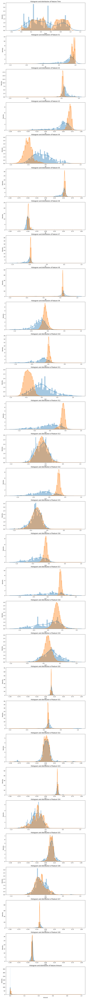

In [78]:
detector.plot_column_distributions()

From the plots, density distribution of both the classes can be observed for all the features. Some class based distributions are similar to each other and those features can be ignored as a part of pre processing.

---

***Applying train-test split on data in 80:20 ratio.***

Creating and saving train and test data so that we can use the same train and test data by loading it in case of runtime restart.

In [79]:
# splitting the data in 80:20 ratio.
train_X, train_y, test_X, test_y = detector.train_test_split(split_val=0.8)

In [81]:
#converting data into csv and save them to use them again if collab disconnet 
train_X.to_csv('train_X.csv')
train_y.to_csv('train_y.csv')
test_X.to_csv('test_X.csv')
test_y.to_csv('test_y.csv')

In [ ]:
! cp  "/content/train_x.csv" "/content/drive/My Drive/PRML/Minor Project"
! cp  "/content/train_y.csv" "/content/drive/My Drive/PRML/Minor Project"
! cp  "/content/test_x.csv" "/content/drive/My Drive/PRML/Minor Project"
! cp  "/content/test_y.csv" "/content/drive/My Drive/PRML/Minor Project"

---

# ***Training Models***

---



---



In [9]:
# reading csvs to get train and test dataset 
train_X = pd.read_csv('split_data/train_x.csv').drop(columns=["Unnamed: 0"])
train_y = pd.read_csv('split_data/train_y.csv').drop(columns=["Unnamed: 0"])
test_X = pd.read_csv('split_data/test_x.csv').drop(columns=["Unnamed: 0"])
test_y = pd.read_csv('split_data/test_y.csv').drop(columns=["Unnamed: 0"])


## ***Normal Data***


---



---

No pre-processing will be applied and completely raw data will be used.

**GuassianNB**

In [9]:
# we have varied the hyperparameters of Gaussian Naive Bayes such as Var_smoothing for hyperparameter tunning to achieve maximum accuaracy.
# we have also stored the best model and the time taken by the best model in training and predicing output.
ans={}
auprc_score=0
time_taken=0
best_model = None
for i in list(i*(1e-10) for i in range(1, 20, 1)):
    st=time.time()
    detector = fraud_detector()
    gnb = GaussianNB(var_smoothing=i)
    detector.model(gnb)
    model = detector.train(train_X,train_y)
    detector.test(test_X)
    auc1 = detector.scores(test_y=test_y, show_graph = False)["Area Under Precision Recall Curve"]
    et=time.time()
    if(auprc_score<auc1):
        best_model = model
        auprc_score = auc1
        ans={"var_smoothing":i}
        time_taken=et-st
    print("For",{"var_smoothing":i},"AUC is",auc1,"time ",et-st,"sec taken")
print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)


For {'var_smoothing': 1e-10} AUC is 0.4139146887922712 time  0.24272513389587402 sec taken
For {'var_smoothing': 2e-10} AUC is 0.4139146887922712 time  0.2295694351196289 sec taken
For {'var_smoothing': 3e-10} AUC is 0.4139146887922712 time  0.22028136253356934 sec taken
For {'var_smoothing': 4e-10} AUC is 0.4139146887922712 time  0.25298476219177246 sec taken
For {'var_smoothing': 5e-10} AUC is 0.4139146887922712 time  0.24091887474060059 sec taken
For {'var_smoothing': 6e-10} AUC is 0.4139146887922712 time  0.2055206298828125 sec taken
For {'var_smoothing': 7.000000000000001e-10} AUC is 0.4139146887922712 time  0.22393441200256348 sec taken
For {'var_smoothing': 8e-10} AUC is 0.4139146887922712 time  0.22121882438659668 sec taken
For {'var_smoothing': 9e-10} AUC is 0.4139146887922712 time  0.212554931640625 sec taken
For {'var_smoothing': 1e-09} AUC is 0.4139146887922712 time  0.22458291053771973 sec taken
For {'var_smoothing': 1.1000000000000001e-09} AUC is 0.4139146887922712 time  

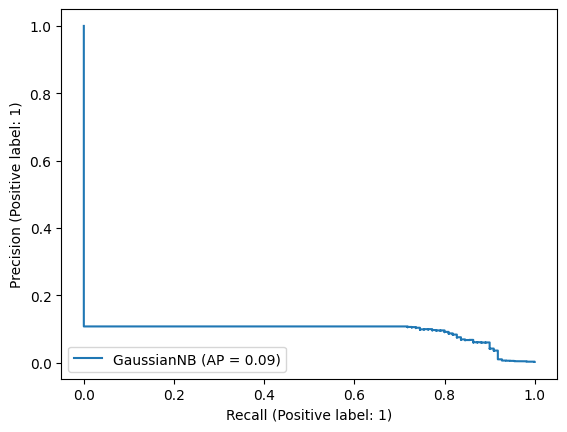

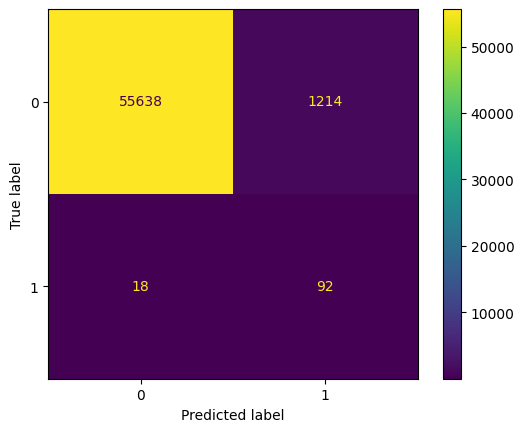

{'Recall': 0.8363636363636363,
 'Precision': 0.07044410413476264,
 'F1_Score': 0.12994350282485875,
 'Area Under Precision Recall Curve': 0.4139146887922712,
 'Confusion Matrix': array([[55638,  1214],
        [   18,    92]], dtype=int64)}

In [10]:
# plotted the precision recall curve along with the confusion matrix with the help of a function of class fraud_detector f0r the previous best trained model
best_model.scores(test_y=test_y, show_graph=True, confusionMatrix=True) 


**XGBOOST**

In [11]:
# we have varied the hyperparameters of XGBOOST such as learning rate, max_depth, min_child_weight, and gamma for hyperparameter tunning to achieve maximum accuaracy with th help of nested for loops
# we have also stored the best model and the time taken by the best model in training and predicing output.

ans={}
auprc_score=0
time_taken=0
best_model = None


for i in [0.05,0.1,0.15,0.2,0.25,0.3,0.35,0.4]:
    for j in range(3,10,1):
        for k in range(4,8):
            for w in [0.0,0.05]:
                st=time.time()
                detector = fraud_detector()
                xgb = XGBClassifier(learning_rate=i,max_depth=j,min_child_weight=k,gamma=w,tree_method='gpu_hist',gpu_id=0,)
                detector.model(xgb)
                model = detector.train(train_X,train_y)
                detector.test(test_X)
                auc1 = detector.scores(test_y=test_y, show_graph = False)["Area Under Precision Recall Curve"]
                et=time.time()
                if(auprc_score<auc1):
                    best_model=model
                    auprc_score=auc1
                    ans = {"learning_rate":i,"max_depth":j,"min_child_weight":k,"gamma":w}
                    time_taken=et-st

                
                print("For",{"learning_rate":i,"max_depth":j,"min_child_weight":k,"gamma":w},"AUC is",auc1,"time ",et-st,"sec taken")
                
print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)

For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 4, 'gamma': 0.0} AUC is 0.8392662694568446 time  1.0151426792144775 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 4, 'gamma': 0.05} AUC is 0.8393903000556158 time  0.6172740459442139 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 5, 'gamma': 0.0} AUC is 0.8391791408004466 time  0.6084895133972168 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 5, 'gamma': 0.05} AUC is 0.8391703746956355 time  0.586489200592041 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 0.0} AUC is 0.8391993302300235 time  0.6004128456115723 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 0.05} AUC is 0.838282014349172 time  0.598797082901001 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 7, 'gamma': 0.0} AUC is 0.8373648009849766 time  0.5988996028900146 sec taken
For {'

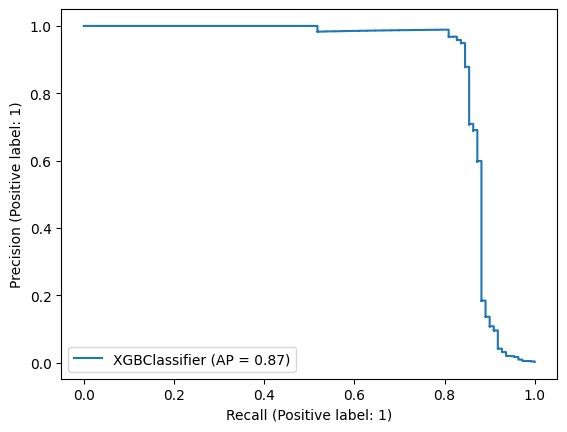

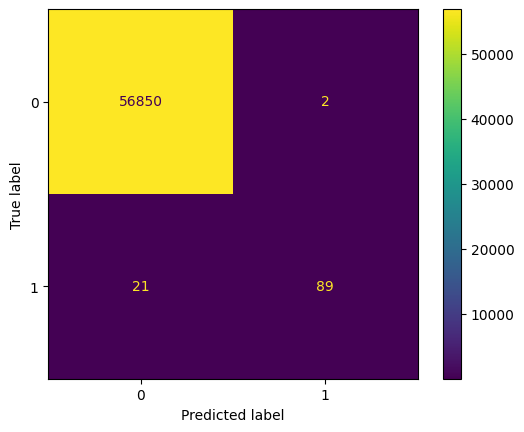

{'Recall': 0.8090909090909091,
 'Precision': 0.978021978021978,
 'F1_Score': 0.8855721393034826,
 'Area Under Precision Recall Curve': 0.8722338246118143,
 'Confusion Matrix': array([[56850,     2],
        [   21,    89]], dtype=int64)}

In [12]:
# plotted the precision recall curve along with the confusion matrix with the help of a function of class fraud_detector f0r the previous best trained model
best_model.scores(test_y=test_y, show_graph=True, confusionMatrix=True)


In [13]:
# A function which returns the area under the precision recall curve by taking model name, and test data.
# First it plots the graph and then calculate it's area. We have done plt.close() to make sure that no graph should be plotted.
def auprc(model,X_test,y_test):
    plt.ioff()
    display = PrecisionRecallDisplay.from_estimator(
    model, X_test, y_test)
    plt.close()
    auc_score = auc(display.recall, display.precision)
    return auc_score


# An exapmple that we can also use a pre build modal by loading it.
with open('xg.pkl','rb') as f:
    model = pickle.load(f)

auc1 = auprc(xgb,test_X,test_y)
print(auc1)

[14:52:08] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:553: 
  If you are loading a serialized model (like pickle in Python, RDS in R) generated by
  older XGBoost, please export the model by calling `Booster.save_model` from that version
  first, then load it back in current version. See:

    https://xgboost.readthedocs.io/en/latest/tutorials/saving_model.html

  for more details about differences between saving model and serializing.

0.8656582448846779


**Logistic Regression**

In [14]:
# we have varied the hyperparameters of Logistic Regression such as solver(an important parameter) for hyperparameter tunning to achieve maximum accuaracy.
# we have also stored the best model and the time taken by the best model in training and predicing output.

ans={}
auprc_score=0
time_taken=0
best_model = None


for i in ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky']:
    lr = LogisticRegression(class_weight="balanced",solver="lbfgs",max_iter=100000)
    st=time.time()
    detector = fraud_detector()
    lr = LogisticRegression(class_weight="balanced",solver=i,max_iter=100000)
    detector.model(lr)
    model = detector.train(train_X,train_y)
    detector.test(test_X)
    auc1 = detector.scores(test_y=test_y, show_graph = False)["Area Under Precision Recall Curve"]
    et=time.time()
    if(auprc_score<auc1):
        best_model=model
        auprc_score=auc1
        ans = {"class_weights":"balanced","solver":i,"max_iter":100000}
        time_taken=et-st


    print("For",{"class_weights":"balanced","solver":i,"max_iter":100000},"AUC is",auc1,"time ",et-st,"sec taken")

print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)    

For {'class_weights': 'balanced', 'solver': 'lbfgs', 'max_iter': 100000} AUC is 0.8165314518505166 time  4.891047477722168 sec taken
For {'class_weights': 'balanced', 'solver': 'liblinear', 'max_iter': 100000} AUC is 0.8201384873880403 time  2.544800043106079 sec taken
For {'class_weights': 'balanced', 'solver': 'newton-cg', 'max_iter': 100000} AUC is 0.8164049800491714 time  4.431519031524658 sec taken
For {'class_weights': 'balanced', 'solver': 'newton-cholesky', 'max_iter': 100000} AUC is 0.8159206804083969 time  0.7868056297302246 sec taken




best score is  0.8201384873880403
with hyper parameters {'class_weights': 'balanced', 'solver': 'liblinear', 'max_iter': 100000}
time required for training 2.544800043106079


**Bagging Classifier**

In [20]:
# we have varied the hyperparameters of Bagging Classifier such as n_estimators for hyperparameter tunning to achieve maximum accuaracy with help of fir loops.
# we have also calulated the time taken by the best model in training and predicing output.


baggingclf = BaggingClassifier()
auprc_score=0
ans={}
best_time=0
for i in range(10,50,10):
    st = time.time()
    baggingclf = BaggingClassifier(n_estimators=i,n_jobs=4)
    baggingclf.fit(train_X,train_y)
    auc1 = auprc(baggingclf,test_X,test_y)
    et = time.time()
    if(auprc_score<auc1):
        auprc_score=auc1
        ans = {"n_estimators":i}
        best_time = et-st
        
    print({"n_estimators":i},"Auc is ",auc1,"time",et-st)

print("best score is ", auprc_score)
print("hypermeter tunned ",ans)
            

{'n_estimators': 10} Auc is  0.8626484388632524 time 38.88062071800232
{'n_estimators': 20} Auc is  0.8622759259427095 time 70.12253642082214
{'n_estimators': 30} Auc is  0.8556915386331656 time 119.76726818084717
{'n_estimators': 40} Auc is  0.8572255219753211 time 139.45824933052063
best score is  0.8626484388632524
hypermeter tunned  {'n_estimators': 10}


**Decision Tree Classifier**

In [15]:
# we have varied the hyperparameters of Decision Tree such as criterion,max_depth, and mini_samples_leaf for hyperparameter tunning to achieve maximum accuaracy with help of fir loops.
# we have stored the best model and also calulated the time taken by the best model in training and predicing output.

ans={}
auprc_score=0
time_taken=0
best_model = None


for i in range(4,7):
    for j in range(40,61,10):
        for k in ['gini','entropy']:

            st=time.time()
            detector = fraud_detector()
            dtc = DecisionTreeClassifier(criterion=k,max_depth=i,min_samples_leaf=j)
            detector.model(dtc)
            model = detector.train(train_X,train_y)
            detector.test(test_X)
            auc1 = detector.scores(test_y=test_y, show_graph = False)["Area Under Precision Recall Curve"]
            et=time.time()
            if(auprc_score<auc1):
                best_model=model
                auprc_score=auc1
                ans = {"criterion":k,"max_depth":i,"max_sample_leaf":j}
                time_taken=et-st


        print("For",{"criterion":k,"max_depth":i,"max_sample_leaf":j},"AUC is",auc1,"time ",et-st,"sec taken")

print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)    



For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 40} AUC is 0.8005550846397429 time  4.372441530227661 sec taken
For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 50} AUC is 0.792548883699878 time  4.402585744857788 sec taken
For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 60} AUC is 0.791533062520835 time  4.348550081253052 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 40} AUC is 0.809850658935505 time  5.431716680526733 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 50} AUC is 0.7970103695471948 time  5.45210075378418 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 60} AUC is 0.7947801853229639 time  5.43347954750061 sec taken
For {'criterion': 'entropy', 'max_depth': 6, 'max_sample_leaf': 40} AUC is 0.8065047573645354 time  6.7199928760528564 sec taken
For {'criterion': 'entropy', 'max_depth': 6, 'max_sample_leaf': 50} AUC is 0.7965614172262665 time  6.807725

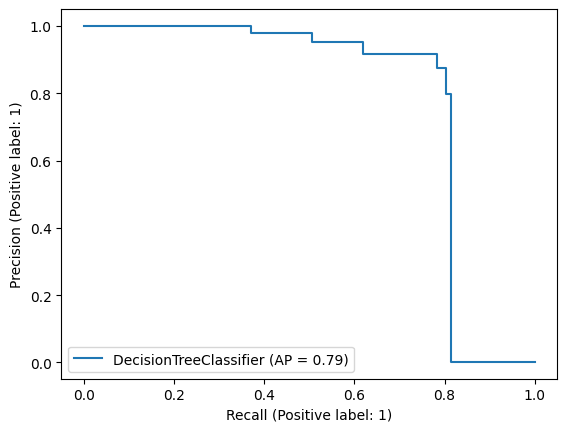

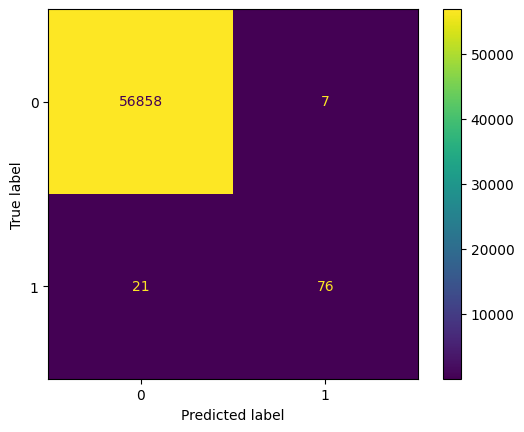

{'Recall': 0.7835051546391752,
 'Precision': 0.9156626506024096,
 'F1_Score': 0.8444444444444443,
 'Area Under Precision Recall Curve': 0.8370767688709391,
 'Confusion Matrix': array([[56858,     7],
        [   21,    76]], dtype=int64)}

In [16]:
# plotted the precision recall curve along with the confusion matrix with the help of a function of class fraud_detector f0r the previous best trained model
best_model.scores(test_y=test_y, show_graph=True, confusionMatrix=True)



In [21]:
# A function which returns the area under the precision recall curve by taking model name, and test data.
# First it plots the graph and then calculate it's area. We have done plt.close() to make sure that no graph should be plotted.

def auprc(model,X_test,y_test):
    plt.ioff()
    display = PrecisionRecallDisplay.from_estimator(
    model, X_test, y_test)
    plt.close()
    auc_score = auc(display.recall, display.precision)
    return auc_score

**Random Forest Classifier**

In [22]:
# we have varied the hyperparameters of Random Forerst Classifier such as max_depth,min_samples_split and mini_samples_leaf for hyperparameter tunning to achieve maximum accuaracy with help of fir loops.
# we have stored the best model and also calulated the time taken by the best model in training and predicing output.
# n_jobs=-1 for using all lorgical processors

auprc_score=0
ans={}

for i in range(3,10,2):
    for j in range(2,10,2):
        for k in range(1,5):
            st = time.time()
            rfc = RandomForestClassifier(max_depth=i,min_samples_split=j,min_samples_leaf=k,n_jobs=-1)
            rfc.fit(train_X,train_y)
            auc1 = auprc(rfc,test_X,test_y)
            if(auprc_score<auc1):
                auprc_score=auc1
                ans = {"max_depth":i,"min_samples_split":j,"min_samples_leaf":k}
            et = time.time()
            print({"max_depth":i,"min_samples_split":j,"min_samples_leaf":k},"    ",auc1,"AUC       ",et-st,"seconds")
            

print("best score is ", auprc_score)
print("hypermeter tunned ",ans)

{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 1}      0.7929694245555096 AUC        6.26759934425354 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 2}      0.7938191337385073 AUC        6.22156834602356 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 3}      0.7896601675695967 AUC        6.233786582946777 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 4}      0.7903958814855535 AUC        6.243024110794067 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 1}      0.7937461799096195 AUC        6.959130764007568 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 2}      0.795808845596304 AUC        7.452054262161255 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 3}      0.7911555070788862 AUC        6.525784492492676 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 4}      0.7909041575761239 AUC        6.249457836151123 seconds
{'m

**KNN**

In [53]:
# we have varied the hyperparameters of KNN such as n_neighgbors for hyperparameter tunning to achieve maximum accuaracy with help of fir loops.
# we have stored the best model and also calulated the time taken by the best model in training and predicing output.

from sklearn.neighbors import KNeighborsClassifier
ans={}
auprc_score=0

for i in range(1,10):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(train_X,train_y)
    auc1 = auprc(knn,test_X,test_y)
    if(auprc_score<auc1):
        auprc_score=auc1
        ans={"n_estimators":i}
print(auprc_score)
print(ans)

0.8805710083452303
{'n_estimators': 3}


## **Normal with Dropping some columns**

In [52]:
clf = fraud_detector(data_x,data_y)
data_X_dropped,data_y_dropped,dump = clf.tranform_data(remove_columns=["V13","V15","V20","V22","V23","V24","V25","V26","V28"])  # dropping given columns from dataset
type(data_X_dropped)

#assigning train and test data with same rows as in previous case for normal data(no scaling) 
train_X_dropped = data_X_dropped.loc[train_y.index]
train_y_dropped = data_y_dropped.loc[train_y.index]
test_X_dropped = data_X_dropped.loc[test_y.index]
test_y_dropped = data_y_dropped.loc[test_y.index]



**GausssainNB**

In [54]:


ans={}
auprc_score=0
time_taken=0
best_model = None
for i in list(i*(1e-10) for i in range(1, 20, 1)):
    st=time.time()
    detector = fraud_detector()
    gnb = GaussianNB(var_smoothing=i)
    detector.model(gnb)
    model = detector.train(train_X_dropped,train_y_dropped)
    detector.test(test_X_dropped)
    auc1 = detector.scores(test_y=test_y_dropped, show_graph = False)["Area Under Precision Recall Curve"]
    et=time.time()
    if(auprc_score<auc1):
        best_model = model
        auprc_score = auc1
        ans={"var_smoothing":i}
        time_taken=et-st
    print("For",{"var_smoothing":i},"AUC is",auc1,"time ",et-st,"sec taken")
print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)


For {'var_smoothing': 1e-10} AUC is 0.416220741846315 time  0.30156517028808594 sec taken
For {'var_smoothing': 2e-10} AUC is 0.416220741846315 time  0.28980183601379395 sec taken
For {'var_smoothing': 3e-10} AUC is 0.416220741846315 time  0.28684043884277344 sec taken
For {'var_smoothing': 4e-10} AUC is 0.416220741846315 time  0.3172578811645508 sec taken
For {'var_smoothing': 5e-10} AUC is 0.416220741846315 time  0.3021819591522217 sec taken
For {'var_smoothing': 6e-10} AUC is 0.416220741846315 time  0.2950870990753174 sec taken
For {'var_smoothing': 7.000000000000001e-10} AUC is 0.416220741846315 time  0.31563401222229004 sec taken
For {'var_smoothing': 8e-10} AUC is 0.416220741846315 time  0.307553768157959 sec taken
For {'var_smoothing': 9e-10} AUC is 0.416220741846315 time  0.29118919372558594 sec taken
For {'var_smoothing': 1e-09} AUC is 0.416220741846315 time  0.3013145923614502 sec taken
For {'var_smoothing': 1.1000000000000001e-09} AUC is 0.416220741846315 time  0.31543517112

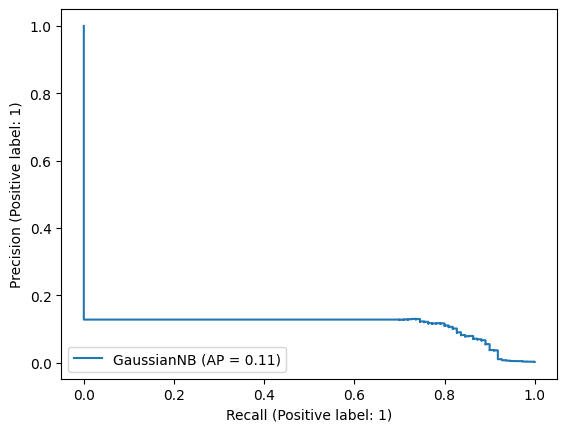

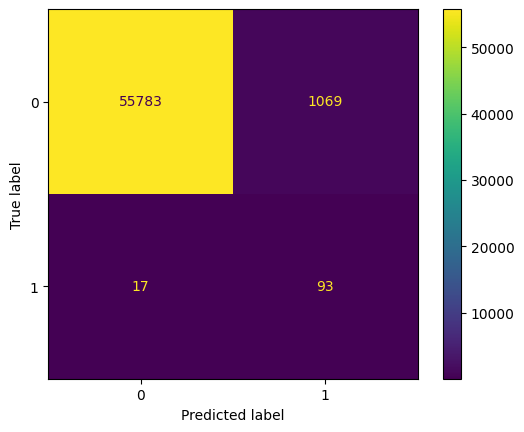

{'Recall': 0.8454545454545455,
 'Precision': 0.08003442340791739,
 'F1_Score': 0.14622641509433965,
 'Area Under Precision Recall Curve': 0.416220741846315,
 'Confusion Matrix': array([[55783,  1069],
        [   17,    93]], dtype=int64)}

In [55]:
best_model.scores(test_y=test_y_dropped, show_graph=True, confusionMatrix=True)


**XGBOOST**

In [56]:

ans={}
auprc_score=0
time_taken=0
best_model = None


for i in [0.05,0.1,0.15,0.2,0.25,0.3,0.35,0.4]:
    for j in range(3,10,1):
        for k in range(4,8):
            for w in [0.0,0.05]:
                st=time.time()
                detector = fraud_detector()
                xgb = XGBClassifier(learning_rate=i,max_depth=j,min_child_weight=k,gamma=w,tree_method='gpu_hist',gpu_id=0,)
                detector.model(xgb)
                model = detector.train(train_X_dropped,train_y_dropped)
                detector.test(test_X_dropped)
                auc1 = detector.scores(test_y=test_y_dropped, show_graph = False)["Area Under Precision Recall Curve"]
                et=time.time()
                if(auprc_score<auc1):
                    best_model=model
                    auprc_score=auc1
                    ans = {"learning_rate":i,"max_depth":j,"min_child_weight":k,"gamma":w}
                    time_taken=et-st

                
                print("For",{"learning_rate":i,"max_depth":j,"min_child_weight":k,"gamma":w},"AUC is",auc1,"time ",et-st,"sec taken")
                
print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)

For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 4, 'gamma': 0.0} AUC is 0.8504842130298778 time  1.20853590965271 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 4, 'gamma': 0.05} AUC is 0.8504088831353906 time  0.9099264144897461 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 5, 'gamma': 0.0} AUC is 0.8506113314031868 time  0.948603630065918 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 5, 'gamma': 0.05} AUC is 0.8505011584111799 time  0.9469966888427734 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 0.0} AUC is 0.8481306584360894 time  0.9183409214019775 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 0.05} AUC is 0.8479577786846806 time  0.969606876373291 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 7, 'gamma': 0.0} AUC is 0.8482863482655829 time  0.9546105861663818 sec taken
For {'l

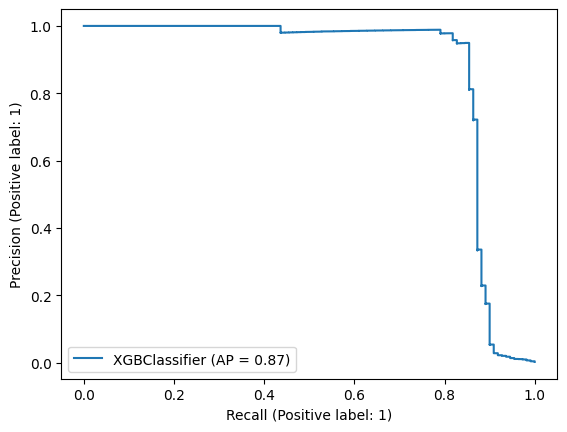

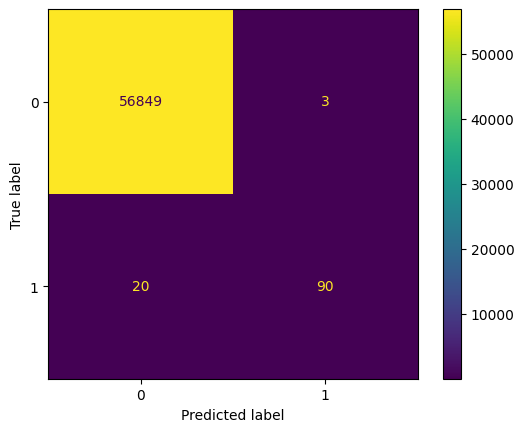

{'Recall': 0.8181818181818182,
 'Precision': 0.967741935483871,
 'F1_Score': 0.8866995073891626,
 'Area Under Precision Recall Curve': 0.8692207283699888,
 'Confusion Matrix': array([[56849,     3],
        [   20,    90]], dtype=int64)}

In [57]:
best_model.scores(test_y=test_y_dropped, show_graph=True, confusionMatrix=True)


**Logistic Regression**

In [58]:
ans={}
auprc_score=0
time_taken=0
best_model = None


for i in ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky']:
    lr = LogisticRegression(class_weight="balanced",solver="lbfgs",max_iter=100000)
    st=time.time()
    detector = fraud_detector()
    lr = LogisticRegression(class_weight="balanced",solver=i,max_iter=100000)
    detector.model(lr)
    model = detector.train(train_X_dropped,train_y_dropped)
    detector.test(test_X_dropped)
    auc1 = detector.scores(test_y=test_y_dropped, show_graph = False)["Area Under Precision Recall Curve"]
    et=time.time()
    if(auprc_score<auc1):
        best_model=model
        auprc_score=auc1
        ans = {"class_weights":"balanced","solver":i,"max_iter":100000}
        time_taken=et-st


    print("For",{"class_weights":"balanced","solver":i,"max_iter":100000},"AUC is",auc1,"time ",et-st,"sec taken")

print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)    

For {'class_weights': 'balanced', 'solver': 'lbfgs', 'max_iter': 100000} AUC is 0.7959899424130636 time  5.896743535995483 sec taken
For {'class_weights': 'balanced', 'solver': 'liblinear', 'max_iter': 100000} AUC is 0.802319698121048 time  3.0485727787017822 sec taken
For {'class_weights': 'balanced', 'solver': 'newton-cg', 'max_iter': 100000} AUC is 0.7959505787925836 time  4.363217115402222 sec taken
For {'class_weights': 'balanced', 'solver': 'newton-cholesky', 'max_iter': 100000} AUC is 0.7945270466265143 time  1.0399911403656006 sec taken




best score is  0.802319698121048
with hyper parameters {'class_weights': 'balanced', 'solver': 'liblinear', 'max_iter': 100000}
time required for training 3.0485727787017822


**Bagging Classifier**

In [59]:
from sklearn.ensemble import BaggingClassifier

baggingclf = BaggingClassifier()
auprc_score=0
ans={}
best_time=0
for i in range(10,50,10):
    st = time.time()
    baggingclf = BaggingClassifier(n_estimators=i,n_jobs=4)
    baggingclf.fit(train_X_dropped,train_y_dropped)
    auc1 = auprc(baggingclf,test_X_dropped,test_y_dropped)
    et = time.time()
    if(auprc_score<auc1):
        auprc_score=auc1
        ans = {"n_estimators":i}
        best_time = et-st
        
    print({"n_estimators":i},"Auc is ",auc1,"time",et-st)

print("best score is ", auprc_score)
print("hypermeter tunned ",ans)
            

{'n_estimators': 10} Auc is  0.8592218431732224 time 52.714099168777466
{'n_estimators': 20} Auc is  0.8496047891687919 time 92.22899460792542
{'n_estimators': 30} Auc is  0.8557178180784313 time 146.54648613929749
{'n_estimators': 40} Auc is  0.8459696373770256 time 177.3254029750824
best score is  0.8592218431732224
hypermeter tunned  {'n_estimators': 10}


**DecisionTreeClassifier**

In [60]:
ans={}
auprc_score=0
time_taken=0
best_model = None


for i in range(4,7):
    for j in range(40,61,10):
        for k in ['gini','entropy']:

            st=time.time()
            detector = fraud_detector()
            dtc = DecisionTreeClassifier(criterion=k,max_depth=i,min_samples_leaf=j)
            detector.model(dtc)
            model = detector.train(train_X_dropped,train_y_dropped)
            detector.test(test_X_dropped)
            auc1 = detector.scores(test_y=test_y_dropped, show_graph = False)["Area Under Precision Recall Curve"]
            et=time.time()
            if(auprc_score<auc1):
                best_model=model
                auprc_score=auc1
                ans = {"criterion":k,"max_depth":i,"max_sample_leaf":j}
                time_taken=et-st


        print("For",{"criterion":k,"max_depth":i,"max_sample_leaf":j},"AUC is",auc1,"time ",et-st,"sec taken")

print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)    



For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 40} AUC is 0.7951056405856821 time  6.981462717056274 sec taken
For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 50} AUC is 0.803236082304749 time  6.984447479248047 sec taken
For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 60} AUC is 0.8184074652927235 time  6.982388973236084 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 40} AUC is 0.8023178399546713 time  8.623902320861816 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 50} AUC is 0.8088582587859492 time  8.999194383621216 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 60} AUC is 0.8175656965860767 time  8.601372003555298 sec taken
For {'criterion': 'entropy', 'max_depth': 6, 'max_sample_leaf': 40} AUC is 0.8085170714118013 time  10.28754210472107 sec taken
For {'criterion': 'entropy', 'max_depth': 6, 'max_sample_leaf': 50} AUC is 0.8109710498565361 time  11.00

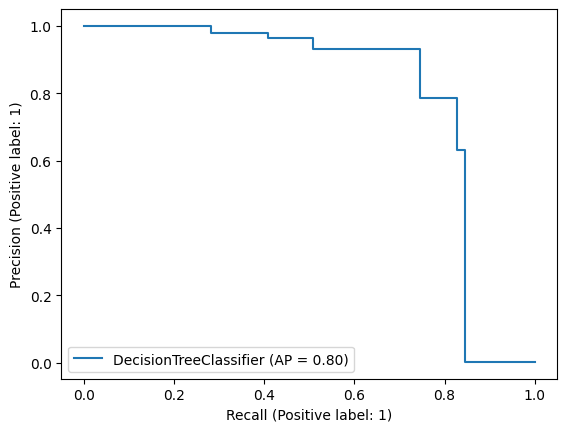

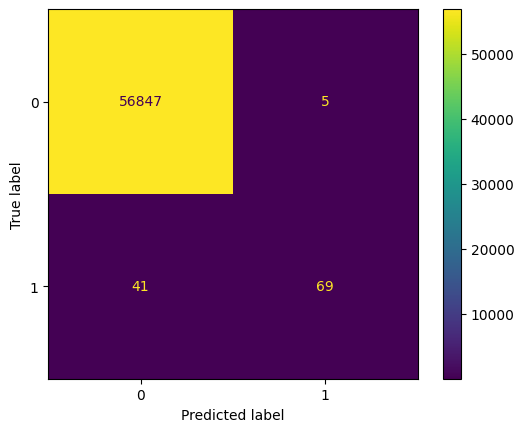

{'Recall': 0.6272727272727273,
 'Precision': 0.9324324324324325,
 'F1_Score': 0.7499999999999999,
 'Area Under Precision Recall Curve': 0.8562259009896274,
 'Confusion Matrix': array([[56847,     5],
        [   41,    69]], dtype=int64)}

In [61]:
best_model.scores(test_y=test_y_dropped, show_graph=True, confusionMatrix=True)


def auprc(model,X_test,y_test):
    plt.ioff()
    display = PrecisionRecallDisplay.from_estimator(
    model, X_test, y_test)
    plt.close()
    auc_score = auc(display.recall, display.precision)
    return auc_score

**RFC**

In [62]:
auprc_score=0
ans={}

for i in range(3,10,2):
    for j in range(2,10,2):
        for k in range(1,5):
            st = time.time()
            rfc = RandomForestClassifier(max_depth=i,min_samples_split=j,min_samples_leaf=k,n_jobs=-1)
            rfc.fit(train_X_dropped,train_y_dropped)
            auc1 = auprc(rfc,test_X_dropped,test_y_dropped)
            if(auprc_score<auc1):
                auprc_score=auc1
                ans = {"max_depth":i,"min_samples_split":j,"min_samples_leaf":k}
            et = time.time()
            print({"max_depth":i,"min_samples_split":j,"min_samples_leaf":k},"    ",auc1,"AUC       ",et-st,"seconds")
            

print("best score is ", auprc_score)
print("hypermeter tunned ",ans)

{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 1}      0.8119429155816534 AUC        8.567689418792725 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 2}      0.815937155194504 AUC        8.475222826004028 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 3}      0.8111789508105379 AUC        8.575055360794067 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 4}      0.816724769300093 AUC        8.556050062179565 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 1}      0.8177880469084677 AUC        8.719315767288208 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 2}      0.8142006840004947 AUC        9.305698871612549 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 3}      0.8181844540542244 AUC        8.742748022079468 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 4}      0.8136858163861178 AUC        8.982733964920044 seconds
{'

**KNN**

In [63]:
from sklearn.neighbors import KNeighborsClassifier
ans={}
auprc_score=0

for i in range(1,10):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(train_X_dropped,train_y_dropped)
    auc1 = auprc(knn,test_X_dropped,test_y_dropped)
    if(auprc_score<auc1):
        auprc_score=auc1
        ans={"n_estimators":i}
print(auprc_score)
print(ans)

0.878364576166633
{'n_estimators': 5}


## ***Scaled Data***

---

---



Applying MiniMax Scaling

(Scaling V columns between -1 and 1)

(Scaling Amount and Time between 0 and 1)


---




In [76]:
def scaleit(data):
    for column in data_x.columns[1:29]:
        data[column] = MinMaxScaler(feature_range=(-1, 1)).fit_transform(np.array(data[column]).reshape(-1,1))

    for column in ['Time', 'Amount']:
        data[column] = MinMaxScaler(feature_range=(0, 1)).fit_transform(np.array(data[column]).reshape(-1,1))
    return data
    
data_x_scaled = scaleit(data_x)
data_x_scaled

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
0,0.000000,0.870385,0.532981,0.762730,-0.373955,0.526877,-0.464663,-0.466370,0.572888,-0.049377,...,0.165884,0.122369,0.045984,0.327586,-0.217495,0.170244,-0.210886,-0.162048,-0.374607,0.005824
1,0.000000,0.957084,0.540133,0.680597,-0.456407,0.532241,-0.475617,-0.470249,0.572597,-0.092038,...,0.159060,0.115680,-0.039526,0.333876,-0.327120,0.174581,-0.107974,-0.167310,-0.373155,0.000105
2,0.000006,0.870434,0.506235,0.736282,-0.462469,0.524658,-0.437756,-0.459646,0.576085,-0.178795,...,0.171710,0.130955,0.092060,0.357878,-0.421292,0.119030,-0.194546,-0.169021,-0.376177,0.014739
3,0.000006,0.883756,0.530608,0.736967,-0.572678,0.531294,-0.448882,-0.466394,0.578868,-0.170001,...,0.156100,0.119467,0.020554,0.325214,-0.552348,0.228491,-0.221607,-0.164663,-0.371258,0.004807
4,0.000012,0.877234,0.553040,0.728501,-0.460407,0.525950,-0.472032,-0.462064,0.564967,-0.018101,...,0.169231,0.122655,0.094541,0.326784,-0.197460,0.132685,0.014994,-0.158878,-0.365020,0.002724
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284802,0.999965,0.512897,0.747061,0.333982,-0.679366,0.459206,-0.526379,-0.529214,0.727498,0.057457,...,0.191958,0.129841,0.030499,0.360999,-0.372801,0.317116,-0.067418,-0.132143,-0.340320,0.000030
284803,0.999971,0.891689,0.533354,0.745356,-0.561622,0.543122,-0.452678,-0.468993,0.577097,-0.034150,...,0.161800,0.129865,0.106307,0.331237,-0.509404,0.087710,-0.278232,-0.164450,-0.375925,0.000965
284804,0.999977,0.981810,0.528159,0.562204,-0.545596,0.566850,-0.413007,-0.472906,0.585969,-0.044646,...,0.160560,0.130440,0.074011,0.329753,-0.063016,0.185647,-0.177647,-0.166814,-0.374830,0.002642
284805,0.999977,0.908418,0.545711,0.699174,-0.434983,0.526344,-0.461419,-0.477650,0.585341,-0.047427,...,0.163244,0.131511,0.094707,0.326017,-0.202328,0.091916,0.029491,-0.162961,-0.369510,0.000389


In [77]:

train_X_scaled = data_x_scaled.loc[train_y.index]
train_y_scaled = data_y.loc[train_y.index]
test_X_scaled = data_x_scaled.loc[test_y.index]
test_y_scaled = data_y.loc[test_y.index]

**GausianNB**

In [ ]:


ans={}
auprc_score=0
time_taken=0
best_model = None
for i in list(i*(1e-10) for i in range(1, 20, 1)):
    st=time.time()
    detector = fraud_detector()
    gnb = GaussianNB(var_smoothing=i)
    detector.model(gnb)
    model = detector.train(train_X_scaled,train_y_scaled)
    detector.test(test_X_scaled)
    auc1 = detector.scores(test_y=test_y_scaled, show_graph = False)["Area Under Precision Recall Curve"]
    et=time.time()
    if(auprc_score<auc1):
        best_model = model
        auprc_score = auc1
        ans={"var_smoothing":i}
        time_taken=et-st
    print("For",{"var_smoothing":i},"AUC is",auc1,"time ",et-st,"sec taken")
print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)


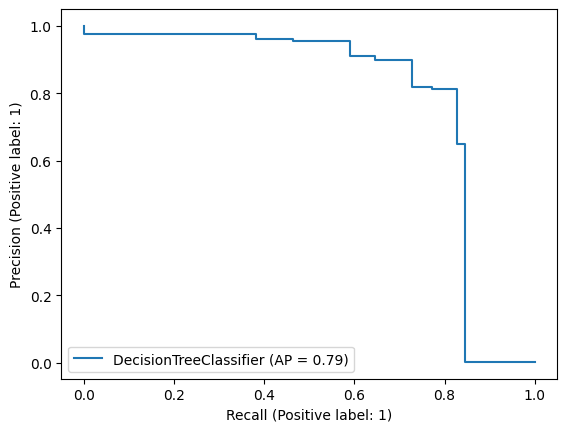

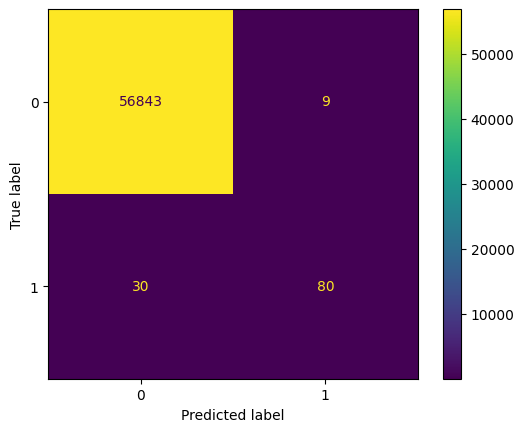

{'Recall': 0.7272727272727273,
 'Precision': 0.898876404494382,
 'F1_Score': 0.8040201005025126,
 'Area Under Precision Recall Curve': 0.8416363198614109,
 'Confusion Matrix': array([[56843,     9],
        [   30,    80]], dtype=int64)}

In [91]:
best_model.scores(test_y=test_y_scaled, show_graph=True, confusionMatrix=True)


**XGBOOST**

In [92]:

ans={}
auprc_score=0
time_taken=0
best_model = None


for i in [0.05,0.1,0.15,0.2,0.25,0.3,0.35,0.4]:
    for j in range(3,10,1):
        for k in range(4,8):
            for w in [0.0,0.05]:
                st=time.time()
                detector = fraud_detector()
                xgb = XGBClassifier(learning_rate=i,max_depth=j,min_child_weight=k,gamma=w,tree_method='gpu_hist',gpu_id=0,)
                detector.model(xgb)
                model = detector.train(train_X_scaled,train_y_scaled)
                detector.test(test_X_scaled)
                auc1 = detector.scores(test_y=test_y_scaled, show_graph = False)["Area Under Precision Recall Curve"]
                et=time.time()
                if(auprc_score<auc1):
                    best_model=model
                    auprc_score=auc1
                    ans = {"learning_rate":i,"max_depth":j,"min_child_weight":k,"gamma":w}
                    time_taken=et-st

                
                print("For",{"learning_rate":i,"max_depth":j,"min_child_weight":k,"gamma":w},"AUC is",auc1,"time ",et-st,"sec taken")
                
print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)

For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 4, 'gamma': 0.0} AUC is 0.8392662694568446 time  1.3707332611083984 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 4, 'gamma': 0.05} AUC is 0.8393903000556158 time  1.1481947898864746 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 5, 'gamma': 0.0} AUC is 0.8391791408004466 time  1.0778861045837402 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 5, 'gamma': 0.05} AUC is 0.8391703746956355 time  1.1098525524139404 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 0.0} AUC is 0.8391993302300235 time  1.0682930946350098 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 0.05} AUC is 0.838282014349172 time  1.148059606552124 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 7, 'gamma': 0.0} AUC is 0.8373648009849766 time  1.0654680728912354 sec taken
For {

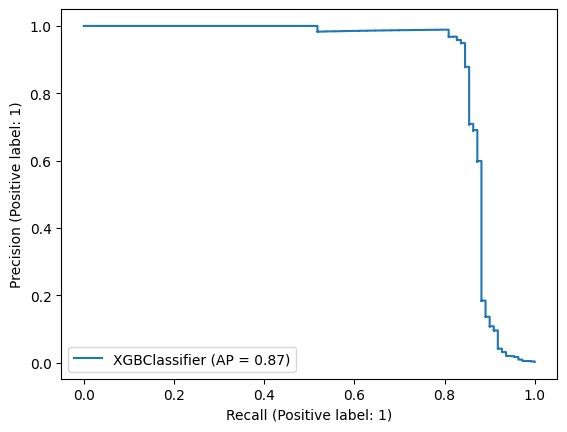

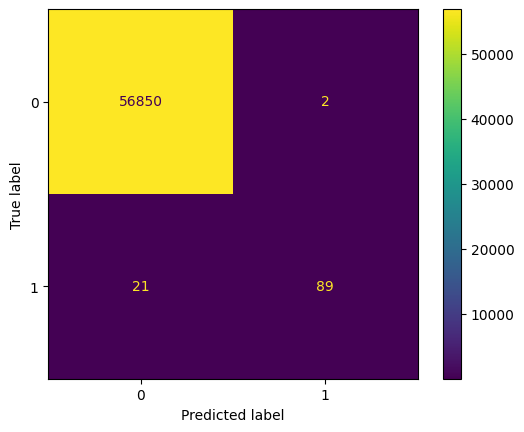

{'Recall': 0.8090909090909091,
 'Precision': 0.978021978021978,
 'F1_Score': 0.8855721393034826,
 'Area Under Precision Recall Curve': 0.8722338246118143,
 'Confusion Matrix': array([[56850,     2],
        [   21,    89]], dtype=int64)}

In [93]:
best_model.scores(test_y=test_y_scaled, show_graph=True, confusionMatrix=True)


**Logistic Regression**

In [94]:
ans={}
auprc_score=0
time_taken=0
best_model = None


for i in ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky']:
    lr = LogisticRegression(class_weight="balanced",solver="lbfgs",max_iter=100000)
    st=time.time()
    detector = fraud_detector()
    lr = LogisticRegression(class_weight="balanced",solver=i,max_iter=100000)
    detector.model(lr)
    model = detector.train(train_X_scaled,train_y_scaled)
    detector.test(test_X_scaled)
    auc1 = detector.scores(test_y=test_y_scaled, show_graph = False)["Area Under Precision Recall Curve"]
    et=time.time()
    if(auprc_score<auc1):
        best_model=model
        auprc_score=auc1
        ans = {"class_weights":"balanced","solver":i,"max_iter":100000}
        time_taken=et-st


    print("For",{"class_weights":"balanced","solver":i,"max_iter":100000},"AUC is",auc1,"time ",et-st,"sec taken")

print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)    

For {'class_weights': 'balanced', 'solver': 'lbfgs', 'max_iter': 100000} AUC is 0.8164044710747933 time  8.190844058990479 sec taken
For {'class_weights': 'balanced', 'solver': 'liblinear', 'max_iter': 100000} AUC is 0.8201384869392119 time  3.975039005279541 sec taken
For {'class_weights': 'balanced', 'solver': 'newton-cg', 'max_iter': 100000} AUC is 0.8164049800491714 time  5.062319755554199 sec taken
For {'class_weights': 'balanced', 'solver': 'newton-cholesky', 'max_iter': 100000} AUC is 0.8159206804083969 time  1.2953786849975586 sec taken




best score is  0.8201384869392119
with hyper parameters {'class_weights': 'balanced', 'solver': 'liblinear', 'max_iter': 100000}
time required for training 3.975039005279541


**DecisionTreeClassifier**

In [95]:
ans={}
auprc_score=0
time_taken=0
best_model = None


for i in range(4,7):
    for j in range(40,61,10):
        for k in ['gini','entropy']:

            st=time.time()
            detector = fraud_detector()
            dtc = DecisionTreeClassifier(criterion=k,max_depth=i,min_samples_leaf=j)
            detector.model(dtc)
            model = detector.train(train_X_scaled,train_y_scaled)
            detector.test(test_X_scaled)
            auc1 = detector.scores(test_y=test_y_scaled, show_graph = False)["Area Under Precision Recall Curve"]
            et=time.time()
            if(auprc_score<auc1):
                best_model=model
                auprc_score=auc1
                ans = {"criterion":k,"max_depth":i,"max_sample_leaf":j}
                time_taken=et-st


        print("For",{"criterion":k,"max_depth":i,"max_sample_leaf":j},"AUC is",auc1,"time ",et-st,"sec taken")

print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)    



For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 40} AUC is 0.8016492547764004 time  9.797510147094727 sec taken
For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 50} AUC is 0.8317786720744738 time  10.365255117416382 sec taken
For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 60} AUC is 0.8372888565125243 time  9.807848453521729 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 40} AUC is 0.8014257172986252 time  12.267621278762817 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 50} AUC is 0.8286725994013705 time  12.157050371170044 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 60} AUC is 0.8336073724843333 time  12.209948539733887 sec taken
For {'criterion': 'entropy', 'max_depth': 6, 'max_sample_leaf': 40} AUC is 0.8037689614786909 time  14.507044315338135 sec taken
For {'criterion': 'entropy', 'max_depth': 6, 'max_sample_leaf': 50} AUC is 0.8307173561296705 time 

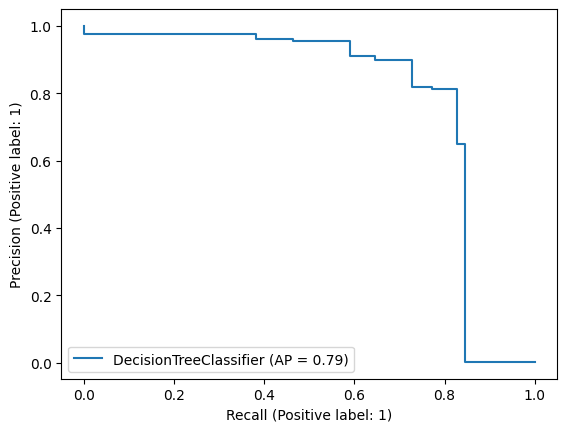

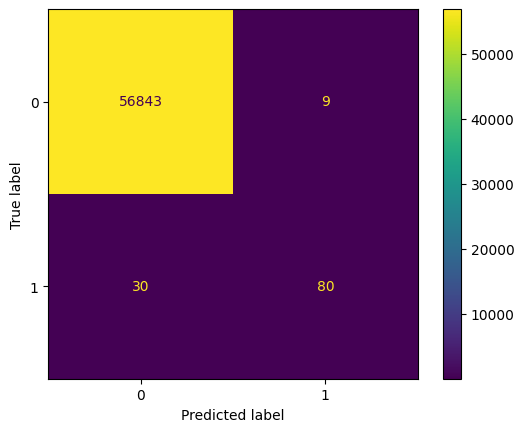

{'Recall': 0.7272727272727273,
 'Precision': 0.898876404494382,
 'F1_Score': 0.8040201005025126,
 'Area Under Precision Recall Curve': 0.8416363198614109,
 'Confusion Matrix': array([[56843,     9],
        [   30,    80]], dtype=int64)}

In [96]:
best_model.scores(test_y=test_y_scaled, show_graph=True, confusionMatrix=True)


In [97]:
def auprc(model,X_test,y_test):
    plt.ioff()
    display = PrecisionRecallDisplay.from_estimator(
    model, X_test, y_test)
    plt.close()
    auc_score = auc(display.recall, display.precision)
    return auc_score

**RFC**

In [98]:
auprc_score=0
ans={}

for i in range(3,10,2):
    for j in range(2,10,2):
        for k in range(1,5):
            st = time.time()
            rfc = RandomForestClassifier(max_depth=i,min_samples_split=j,min_samples_leaf=k,n_jobs=-1)
            rfc.fit(train_X_scaled,train_y_scaled)
            auc1 = auprc(rfc,test_X_scaled,test_y_scaled)
            if(auprc_score<auc1):
                auprc_score=auc1
                ans = {"max_depth":i,"min_samples_split":j,"min_samples_leaf":k}
            et = time.time()
            print({"max_depth":i,"min_samples_split":j,"min_samples_leaf":k},"    ",auc1,"AUC       ",et-st,"seconds")
            

print("best score is ", auprc_score)
print("hypermeter tunned ",ans)

{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 1}      0.8109743223564443 AUC        10.65624451637268 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 2}      0.8183312415781638 AUC        9.896078109741211 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 3}      0.8145378167923948 AUC        9.92514443397522 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 4}      0.8238623778229046 AUC        10.049729108810425 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 1}      0.8085767436236531 AUC        9.864261388778687 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 2}      0.8192301194527332 AUC        9.900244951248169 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 3}      0.8172173152318613 AUC        9.9030179977417 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 4}      0.8145005664084352 AUC        10.110741138458252 seconds
{

**KNN**

In [99]:
from sklearn.neighbors import KNeighborsClassifier
ans={}
auprc_score=0

for i in range(1,10):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(train_X_scaled,train_y_scaled)
    auc1 = auprc(knn,test_X_scaled,test_y_scaled)
    if(auprc_score<auc1):
        auprc_score=auc1
        ans={"n_estimators":i}
print(auprc_score)
print(ans)

0.8805710083452303
{'n_estimators': 3}


In [100]:
clf = fraud_detector(data_x_scaled,data_y)
data_X_dropped_scaled,data_y_dropped_scaled,dump = clf.tranform_data(remove_columns=["V13","V15","V20","V22","V23","V24","V25","V26","V28"])
# type(data_X_dropped)

train_X_dropped_scaled = data_X_dropped_scaled.loc[train_y.index]
train_y_dropped_scaled = data_y_dropped_scaled.loc[train_y.index]
test_X_dropped_scaled = data_X_dropped_scaled.loc[test_y.index]
test_y_dropped_scaled = data_y_dropped_scaled.loc[test_y.index]



***GaussainNB***

In [101]:


ans={}
auprc_score=0
time_taken=0
best_model = None
for i in list(i*(1e-10) for i in range(1, 20, 1)):
    st=time.time()
    detector = fraud_detector()
    gnb = GaussianNB(var_smoothing=i)
    detector.model(gnb)
    model = detector.train(train_X_scaled,train_y_scaled)
    detector.test(test_X_scaled)
    auc1 = detector.scores(test_y=test_y_scaled, show_graph = False)["Area Under Precision Recall Curve"]
    et=time.time()
    if(auprc_score<auc1):
        best_model = model
        auprc_score = auc1
        ans={"var_smoothing":i}
        time_taken=et-st
    print("For",{"var_smoothing":i},"AUC is",auc1,"time ",et-st,"sec taken")
print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)


For {'var_smoothing': 1e-10} AUC is 0.4139146887922712 time  0.3737785816192627 sec taken
For {'var_smoothing': 2e-10} AUC is 0.4139146887922712 time  0.3389291763305664 sec taken
For {'var_smoothing': 3e-10} AUC is 0.4139146887922712 time  0.36028432846069336 sec taken
For {'var_smoothing': 4e-10} AUC is 0.4139146887922712 time  0.34178757667541504 sec taken
For {'var_smoothing': 5e-10} AUC is 0.4139146887922712 time  0.33032751083374023 sec taken
For {'var_smoothing': 6e-10} AUC is 0.4139146887922712 time  0.350508451461792 sec taken
For {'var_smoothing': 7.000000000000001e-10} AUC is 0.4139146887922712 time  0.3435671329498291 sec taken
For {'var_smoothing': 8e-10} AUC is 0.4139146887922712 time  0.3498847484588623 sec taken
For {'var_smoothing': 9e-10} AUC is 0.4139146887922712 time  0.33571434020996094 sec taken
For {'var_smoothing': 1e-09} AUC is 0.4139146887922712 time  0.3400154113769531 sec taken
For {'var_smoothing': 1.1000000000000001e-09} AUC is 0.4139146887922712 time  0.3

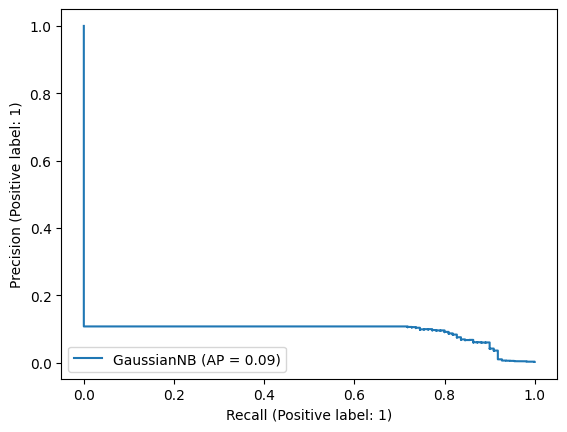

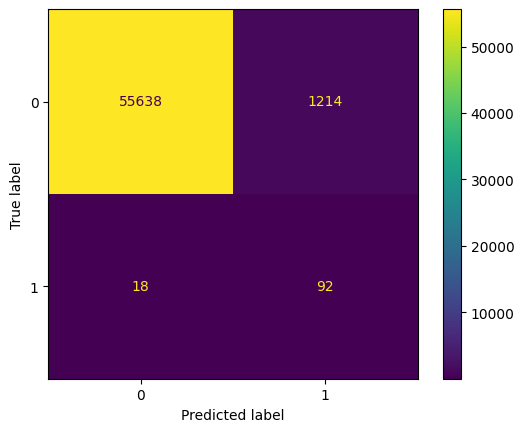

{'Recall': 0.8363636363636363,
 'Precision': 0.07044410413476264,
 'F1_Score': 0.12994350282485875,
 'Area Under Precision Recall Curve': 0.4139146887922712,
 'Confusion Matrix': array([[55638,  1214],
        [   18,    92]], dtype=int64)}

In [102]:
best_model.scores(test_y=test_y_scaled, show_graph=True, confusionMatrix=True)


**XGBOOST**

In [103]:

ans={}
auprc_score=0
time_taken=0
best_model = None


for i in [0.05,0.1,0.15,0.2,0.25,0.3,0.35,0.4]:
    for j in range(3,10,1):
        for k in range(4,8):
            for w in [0.0,0.05]:
                st=time.time()
                detector = fraud_detector()
                xgb = XGBClassifier(learning_rate=i,max_depth=j,min_child_weight=k,gamma=w,tree_method='gpu_hist',gpu_id=0,)
                detector.model(xgb)
                model = detector.train(train_X_scaled,train_y_scaled)
                detector.test(test_X_scaled)
                auc1 = detector.scores(test_y=test_y_scaled, show_graph = False)["Area Under Precision Recall Curve"]
                et=time.time()
                if(auprc_score<auc1):
                    best_model=model
                    auprc_score=auc1
                    ans = {"learning_rate":i,"max_depth":j,"min_child_weight":k,"gamma":w}
                    time_taken=et-st

                
                print("For",{"learning_rate":i,"max_depth":j,"min_child_weight":k,"gamma":w},"AUC is",auc1,"time ",et-st,"sec taken")
                
print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)

For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 4, 'gamma': 0.0} AUC is 0.8392662694568446 time  2.5764076709747314 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 4, 'gamma': 0.05} AUC is 0.8393903000556158 time  1.0484018325805664 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 5, 'gamma': 0.0} AUC is 0.8391791408004466 time  0.9658551216125488 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 5, 'gamma': 0.05} AUC is 0.8391703746956355 time  0.9984695911407471 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 0.0} AUC is 0.8391993302300235 time  1.0405666828155518 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 0.05} AUC is 0.838282014349172 time  1.0223493576049805 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 7, 'gamma': 0.0} AUC is 0.8373648009849766 time  1.0644595623016357 sec taken
For 

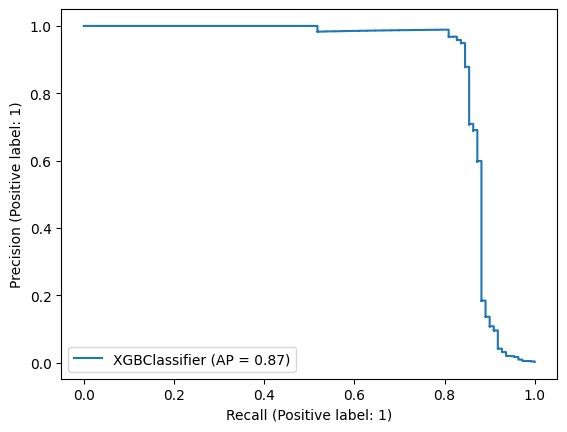

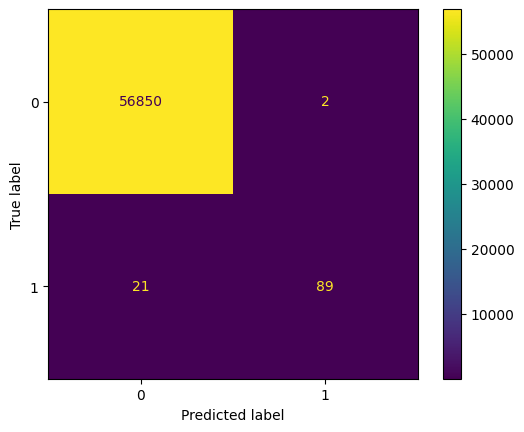

{'Recall': 0.8090909090909091,
 'Precision': 0.978021978021978,
 'F1_Score': 0.8855721393034826,
 'Area Under Precision Recall Curve': 0.8722338246118143,
 'Confusion Matrix': array([[56850,     2],
        [   21,    89]], dtype=int64)}

In [104]:
best_model.scores(test_y=test_y_scaled, show_graph=True, confusionMatrix=True)


**Logistic Regression**

In [105]:
ans={}
auprc_score=0
time_taken=0
best_model = None


for i in ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky']:
    lr = LogisticRegression(class_weight="balanced",solver="lbfgs",max_iter=100000)
    st=time.time()
    detector = fraud_detector()
    lr = LogisticRegression(class_weight="balanced",solver=i,max_iter=100000)
    detector.model(lr)
    model = detector.train(train_X_scaled,train_y_scaled)
    detector.test(test_X_scaled)
    auc1 = detector.scores(test_y=test_y_scaled, show_graph = False)["Area Under Precision Recall Curve"]
    et=time.time()
    if(auprc_score<auc1):
        best_model=model
        auprc_score=auc1
        ans = {"class_weights":"balanced","solver":i,"max_iter":100000}
        time_taken=et-st


    print("For",{"class_weights":"balanced","solver":i,"max_iter":100000},"AUC is",auc1,"time ",et-st,"sec taken")

print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)    

For {'class_weights': 'balanced', 'solver': 'lbfgs', 'max_iter': 100000} AUC is 0.8164044710747933 time  8.701640129089355 sec taken
For {'class_weights': 'balanced', 'solver': 'liblinear', 'max_iter': 100000} AUC is 0.8201384869392119 time  4.648593425750732 sec taken
For {'class_weights': 'balanced', 'solver': 'newton-cg', 'max_iter': 100000} AUC is 0.8164049800491714 time  5.3598456382751465 sec taken
For {'class_weights': 'balanced', 'solver': 'newton-cholesky', 'max_iter': 100000} AUC is 0.8159206804083969 time  1.5909831523895264 sec taken




best score is  0.8201384869392119
with hyper parameters {'class_weights': 'balanced', 'solver': 'liblinear', 'max_iter': 100000}
time required for training 4.648593425750732


**DecisionTreeClassifier**

In [106]:
ans={}
auprc_score=0
time_taken=0
best_model = None


for i in range(4,7):
    for j in range(40,61,10):
        for k in ['gini','entropy']:

            st=time.time()
            detector = fraud_detector()
            dtc = DecisionTreeClassifier(criterion=k,max_depth=i,min_samples_leaf=j)
            detector.model(dtc)
            model = detector.train(train_X_scaled,train_y_scaled)
            detector.test(test_X_scaled)
            auc1 = detector.scores(test_y=test_y_scaled, show_graph = False)["Area Under Precision Recall Curve"]
            et=time.time()
            if(auprc_score<auc1):
                best_model=model
                auprc_score=auc1
                ans = {"criterion":k,"max_depth":i,"max_sample_leaf":j}
                time_taken=et-st


        print("For",{"criterion":k,"max_depth":i,"max_sample_leaf":j},"AUC is",auc1,"time ",et-st,"sec taken")

print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)    



For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 40} AUC is 0.8016492547764004 time  10.720382690429688 sec taken
For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 50} AUC is 0.8319010765574448 time  10.797921657562256 sec taken
For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 60} AUC is 0.8369884884803422 time  10.618110656738281 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 40} AUC is 0.8014257172986252 time  13.632227659225464 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 50} AUC is 0.8285019867124258 time  13.084232330322266 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 60} AUC is 0.8337259872426592 time  13.688979387283325 sec taken
For {'criterion': 'entropy', 'max_depth': 6, 'max_sample_leaf': 40} AUC is 0.8048692563552478 time  15.50845217704773 sec taken
For {'criterion': 'entropy', 'max_depth': 6, 'max_sample_leaf': 50} AUC is 0.8306062882716178 time

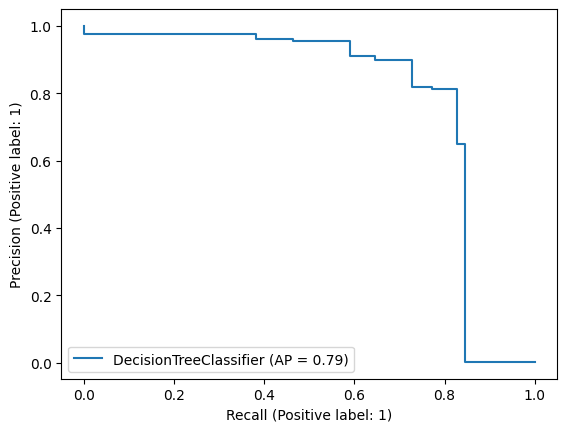

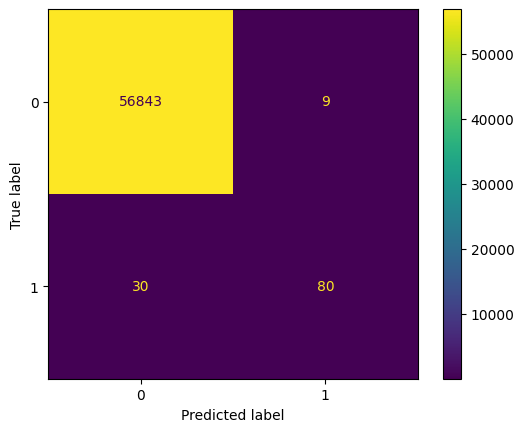

{'Recall': 0.7272727272727273,
 'Precision': 0.898876404494382,
 'F1_Score': 0.8040201005025126,
 'Area Under Precision Recall Curve': 0.8416363198614109,
 'Confusion Matrix': array([[56843,     9],
        [   30,    80]], dtype=int64)}

In [107]:
best_model.scores(test_y=test_y_scaled, show_graph=True, confusionMatrix=True)


In [108]:
def auprc(model,X_test,y_test):
    plt.ioff()
    display = PrecisionRecallDisplay.from_estimator(
    model, X_test, y_test)
    plt.close()
    auc_score = auc(display.recall, display.precision)
    return auc_score

**RFC**

In [ ]:
auprc_score=0
ans={}

for i in range(3,10,2):
    for j in range(2,10,2):
        for k in range(1,5):
            st = time.time()
            rfc = RandomForestClassifier(max_depth=i,min_samples_split=j,min_samples_leaf=k,n_jobs=-1)
            rfc.fit(train_X_scaled,train_y_scaled)
            auc1 = auprc(rfc,test_X_scaled,test_y_scaled)
            if(auprc_score<auc1):
                auprc_score=auc1
                ans = {"max_depth":i,"min_samples_split":j,"min_samples_leaf":k}
            et = time.time()
            print({"max_depth":i,"min_samples_split":j,"min_samples_leaf":k},"    ",auc1,"AUC       ",et-st,"seconds")
            

print("best score is ", auprc_score)
print("hypermeter tunned ",ans)

{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 1}      0.8177244156366926 AUC        10.763840198516846 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 2}      0.8152880243647543 AUC        10.96108078956604 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 3}      0.8203418913706609 AUC        10.839058637619019 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 4}      0.8168561027866436 AUC        10.661703109741211 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 1}      0.8159949470706259 AUC        11.130731105804443 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 2}      0.8158668339332815 AUC        10.473223209381104 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 3}      0.8178671311850456 AUC        10.672614336013794 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 4}      0.8176564294243096 AUC        10.682727575302124 s

**KNN**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
ans={}
auprc_score=0

for i in range(1,10):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(train_X_scaled,train_y_scaled)
    auc1 = auprc(knn,test_X_scaled,test_y_scaled)
    if(auprc_score<auc1):
        auprc_score=auc1
        ans={"n_estimators":i}
print(auprc_score)
print(ans)

## Normal data with smote

In [58]:
detector_smote = fraud_detector(data_x,data_y)

In [59]:
train_x_smote,train_y_smote,test_x_smote,test_y_smote = detector_smote.train_test_split(split_val=0.8)

In [60]:
detector_smote.tranform_data(oversample="smote")  #applied over sampling using SMOTE in training data


(            Time         V1         V2        V3        V4        V5  \
 0            0.0  -1.359807  -0.072781  2.536347  1.378155 -0.338321   
 1            0.0   1.191857   0.266151  0.166480  0.448154  0.060018   
 2            1.0  -1.358354  -1.340163  1.773209  0.379780 -0.503198   
 3            1.0  -0.966272  -0.185226  1.792993 -0.863291 -0.010309   
 4            2.0  -1.158233   0.877737  1.548718  0.403034 -0.407193   
 ...          ...        ...        ...       ...       ...       ...   
 284802  172786.0 -11.881118  10.071785 -9.834783 -2.066656 -5.364473   
 284803  172787.0  -0.732789  -0.055080  2.035030 -0.738589  0.868229   
 284804  172788.0   1.919565  -0.301254 -3.249640 -0.557828  2.630515   
 284805  172788.0  -0.240440   0.530483  0.702510  0.689799 -0.377961   
 284806  172792.0  -0.533413  -0.189733  0.703337 -0.506271 -0.012546   
 
               V6        V7        V8        V9  ...       V20       V21  \
 0       0.462388  0.239599  0.098698  0.36378

**XGBOST**

In [61]:

ans={}
auprc_score=0
time_taken=0
best_model = None


for i in [0.05,0.1,0.15,0.2,0.25]:
    for j in range(3,10,1):
        for k in range(4,8):
            for w in [0.0]:
                st=time.time()
                detector = fraud_detector()
                xgb = XGBClassifier(learning_rate=i,max_depth=j,min_child_weight=k,gamma=w,tree_method='gpu_hist',gpu_id=0,)
                detector.model(xgb)
                model = detector.train(train_x_smote,train_y_smote)
                detector.test(test_x_smote)
                auc1 = detector.scores(test_y=test_y_smote,show_graph = False)["Area Under Precision Recall Curve"]
                et=time.time()
                if(auprc_score<auc1):
                    best_model=model
                    auprc_score=auc1
                    ans = {"learning_rate":i,"max_depth":j,"min_child_weight":k,"gamma":w}
                    time_taken=et-st

                
                print("For",{"learning_rate":i,"max_depth":j,"min_child_weight":k,"gamma":w},"AUC is",auc1,"time ",et-st,"sec taken")
                
print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)

For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 4, 'gamma': 0.0} AUC is 0.8724105618321356 time  1.7522783279418945 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 5, 'gamma': 0.0} AUC is 0.8731996692037646 time  1.6012651920318604 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 6, 'gamma': 0.0} AUC is 0.8741452328358109 time  1.4837162494659424 sec taken
For {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 7, 'gamma': 0.0} AUC is 0.8758430467930651 time  1.5200660228729248 sec taken
For {'learning_rate': 0.05, 'max_depth': 4, 'min_child_weight': 4, 'gamma': 0.0} AUC is 0.8861803582706025 time  1.729454755783081 sec taken
For {'learning_rate': 0.05, 'max_depth': 4, 'min_child_weight': 5, 'gamma': 0.0} AUC is 0.887689498145588 time  1.620211124420166 sec taken
For {'learning_rate': 0.05, 'max_depth': 4, 'min_child_weight': 6, 'gamma': 0.0} AUC is 0.8856079247491825 time  1.6125593185424805 sec taken
For {'lea

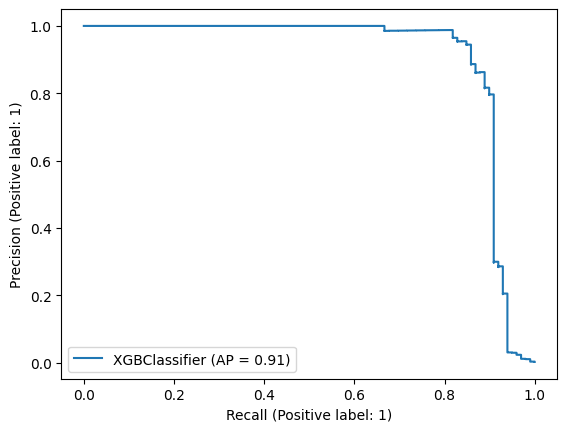

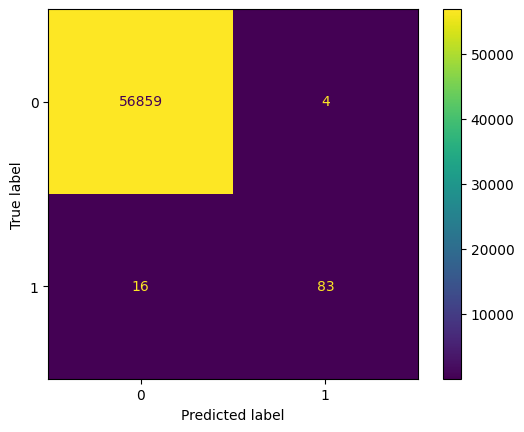

{'Recall': 0.8383838383838383,
 'Precision': 0.9540229885057471,
 'F1_Score': 0.8924731182795698,
 'Area Under Precision Recall Curve': 0.9063255292562434,
 'Confusion Matrix': array([[56859,     4],
        [   16,    83]], dtype=int64)}

In [62]:
best_model.scores(test_y=test_y_smote, show_graph=True, confusionMatrix=True)


**GaussainNB**

In [63]:
ans={}
auprc_score=0
time_taken=0
best_model = None
for i in list(i*(1e-10) for i in range(1, 20, 1)):
    st=time.time()
    detector = fraud_detector()
    gnb = GaussianNB(var_smoothing=i)
    detector.model(gnb)
    model = detector.train(train_x_smote,train_y_smote)
    detector.test(test_x_smote)
    auc1 = detector.scores(test_y=test_y_smote, show_graph = False)["Area Under Precision Recall Curve"]
    et=time.time()
    if(auprc_score<auc1):
        best_model = model
        auprc_score = auc1
        ans={"var_smoothing":i}
        time_taken=et-st
    print("For",{"var_smoothing":i},"AUC is",auc1,"time ",et-st,"sec taken")
print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)


For {'var_smoothing': 1e-10} AUC is 0.3985474526293401 time  0.5560002326965332 sec taken
For {'var_smoothing': 2e-10} AUC is 0.3942823960432818 time  0.5088810920715332 sec taken
For {'var_smoothing': 3e-10} AUC is 0.398347723549342 time  0.434906005859375 sec taken
For {'var_smoothing': 4e-10} AUC is 0.38164216436889903 time  0.43941402435302734 sec taken
For {'var_smoothing': 5e-10} AUC is 0.3743205853684532 time  0.35401105880737305 sec taken
For {'var_smoothing': 6e-10} AUC is 0.35705175797175487 time  0.40110230445861816 sec taken
For {'var_smoothing': 7.000000000000001e-10} AUC is 0.33766113009387444 time  0.3949434757232666 sec taken
For {'var_smoothing': 8e-10} AUC is 0.3375869551668602 time  0.3673746585845947 sec taken
For {'var_smoothing': 9e-10} AUC is 0.3369196570131102 time  0.3707091808319092 sec taken
For {'var_smoothing': 1e-09} AUC is 0.3340624184060566 time  0.3700680732727051 sec taken
For {'var_smoothing': 1.1000000000000001e-09} AUC is 0.3271461606864749 time  0.

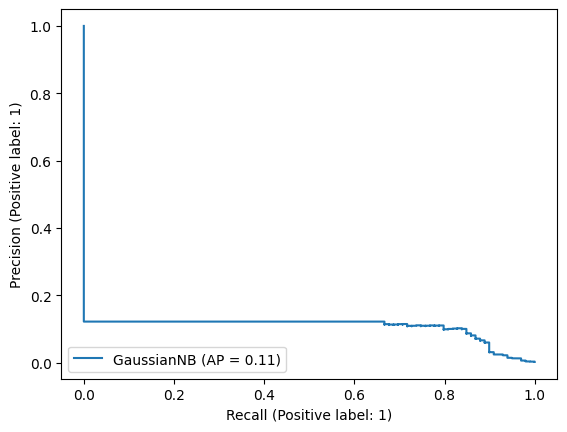

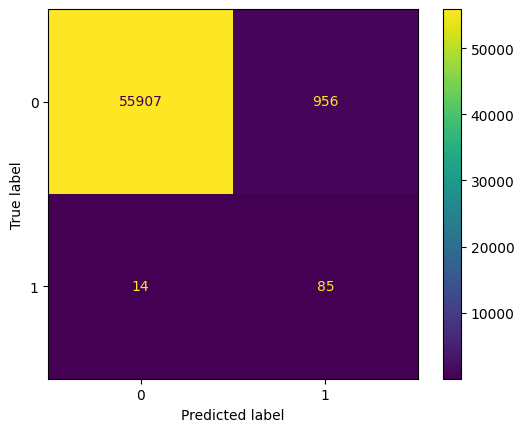

{'Recall': 0.8585858585858586,
 'Precision': 0.08165225744476465,
 'F1_Score': 0.14912280701754385,
 'Area Under Precision Recall Curve': 0.3985474526293401,
 'Confusion Matrix': array([[55907,   956],
        [   14,    85]], dtype=int64)}

In [64]:
best_model.scores(test_y=test_y_smote, show_graph=True, confusionMatrix=True)


**Logistic Regression**

In [65]:
ans={}
auprc_score=0
time_taken=0
best_model = None


for i in ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky']:
    lr = LogisticRegression(class_weight="balanced",solver="lbfgs",max_iter=100000)
    st=time.time()
    detector = fraud_detector()
    lr = LogisticRegression(class_weight="balanced",solver=i,max_iter=100000)
    detector.model(lr)
    model = detector.train(train_x_smote,train_y_smote)
    detector.test(test_x_smote)
    auc1 = detector.scores(test_y=test_y_smote, show_graph = False)["Area Under Precision Recall Curve"]
    et=time.time()
    if(auprc_score<auc1):
        best_model=model
        auprc_score=auc1
        ans = {"class_weights":"balanced","solver":i,"max_iter":100000}
        time_taken=et-st


    print("For",{"class_weights":"balanced","solver":i,"max_iter":100000},"AUC is",auc1,"time ",et-st,"sec taken")

print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)    

For {'class_weights': 'balanced', 'solver': 'lbfgs', 'max_iter': 100000} AUC is 0.7404945247008509 time  3.3384945392608643 sec taken
For {'class_weights': 'balanced', 'solver': 'liblinear', 'max_iter': 100000} AUC is 0.8068914349356063 time  7.331496477127075 sec taken
For {'class_weights': 'balanced', 'solver': 'newton-cg', 'max_iter': 100000} AUC is 0.806864805066734 time  32.817160844802856 sec taken
For {'class_weights': 'balanced', 'solver': 'newton-cholesky', 'max_iter': 100000} AUC is 0.8068664253215123 time  2.0103988647460938 sec taken




best score is  0.8068914349356063
with hyper parameters {'class_weights': 'balanced', 'solver': 'liblinear', 'max_iter': 100000}
time required for training 7.331496477127075


**DTC**

In [66]:
ans={}
auprc_score=0
time_taken=0
best_model = None


for i in range(4,7):
    for j in range(40,61,10):
        for k in ['gini','entropy']:

            st=time.time()
            detector = fraud_detector()
            dtc = DecisionTreeClassifier(criterion=k,max_depth=i,min_samples_leaf=j)
            detector.model(dtc)
            model = detector.train(train_x_smote,train_y_smote)
            detector.test(test_x_smote)
            auc1 = detector.scores(test_y=test_y_smote, show_graph = False)["Area Under Precision Recall Curve"]
            et=time.time()
            if(auprc_score<auc1):
                best_model=model
                auprc_score=auc1
                ans = {"criterion":k,"max_depth":i,"max_sample_leaf":j}
                time_taken=et-st


        print("For",{"criterion":k,"max_depth":i,"max_sample_leaf":j},"AUC is",auc1,"time ",et-st,"sec taken")

print("\n\n\n")
print("best score is ",auprc_score)
print("with hyper parameters",ans)
print("time required for training",time_taken)    



For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 40} AUC is 0.8377794727229944 time  11.255822658538818 sec taken
For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 50} AUC is 0.8387342282701935 time  11.194174528121948 sec taken
For {'criterion': 'entropy', 'max_depth': 4, 'max_sample_leaf': 60} AUC is 0.8266488240235198 time  11.469289541244507 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 40} AUC is 0.8461075514956399 time  13.83148717880249 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 50} AUC is 0.8480234712933046 time  14.405365943908691 sec taken
For {'criterion': 'entropy', 'max_depth': 5, 'max_sample_leaf': 60} AUC is 0.818574910501001 time  14.299681901931763 sec taken
For {'criterion': 'entropy', 'max_depth': 6, 'max_sample_leaf': 40} AUC is 0.8407103272143471 time  16.210171699523926 sec taken
For {'criterion': 'entropy', 'max_depth': 6, 'max_sample_leaf': 50} AUC is 0.8437317429855615 time 

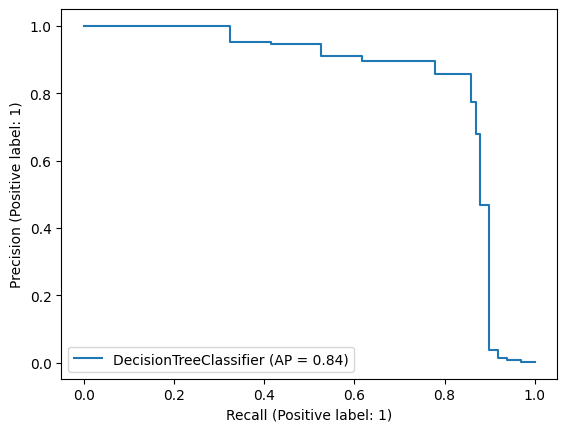

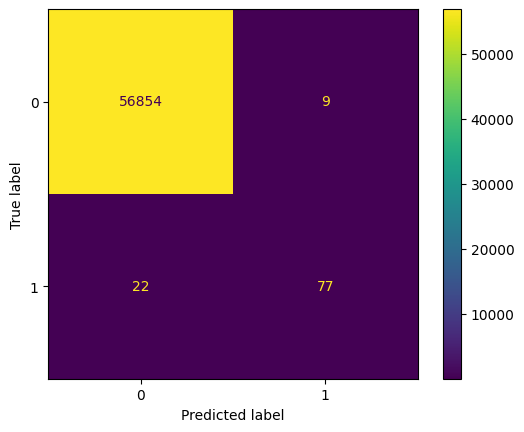

{'Recall': 0.7777777777777778,
 'Precision': 0.8953488372093024,
 'F1_Score': 0.8324324324324325,
 'Area Under Precision Recall Curve': 0.8480234712933046,
 'Confusion Matrix': array([[56854,     9],
        [   22,    77]], dtype=int64)}

In [67]:
best_model.scores(test_y=test_y_smote, show_graph=True, confusionMatrix=True)


**RFC**

In [68]:
def auprc(model,X_test,y_test):
    plt.ioff()
    display = PrecisionRecallDisplay.from_estimator(
    model, X_test, y_test)
    plt.close()
    auc_score = auc(display.recall, display.precision)
    return auc_score
auprc_score=0
ans={}


In [69]:

for i in range(3,7,2):
    for j in range(2,5,2):
        for k in range(1,5,2):
            st = time.time()
            rfc = RandomForestClassifier(max_depth=i,min_samples_split=j,min_samples_leaf=k,n_jobs=-1)
            rfc.fit(train_x_smote,train_y_smote)
            auc1 = auprc(rfc,test_x_smote,test_y_smote)
            if(auprc_score<auc1):
                auprc_score=auc1
                ans = {"max_depth":i,"min_samples_split":j,"min_samples_leaf":k}
            et = time.time()
            print({"max_depth":i,"min_samples_split":j,"min_samples_leaf":k},"    ",auc1,"AUC       ",et-st,"seconds")
            

print("best score is ", auprc_score)
print("hypermeter tunned ",ans)

{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 1}      0.8356238067797901 AUC        11.438988447189331 seconds
{'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 3}      0.8309965707938683 AUC        11.285500526428223 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 1}      0.8308454597588547 AUC        11.5130615234375 seconds
{'max_depth': 3, 'min_samples_split': 4, 'min_samples_leaf': 3}      0.8287524122424038 AUC        11.538039207458496 seconds
{'max_depth': 5, 'min_samples_split': 2, 'min_samples_leaf': 1}      0.8611121903303044 AUC        18.666667938232422 seconds
{'max_depth': 5, 'min_samples_split': 2, 'min_samples_leaf': 3}      0.8619108548851222 AUC        18.555320739746094 seconds
{'max_depth': 5, 'min_samples_split': 4, 'min_samples_leaf': 1}      0.8612067830229314 AUC        17.378156423568726 seconds
{'max_depth': 5, 'min_samples_split': 4, 'min_samples_leaf': 3}      0.8583194177481392 AUC        18.78161382675171 sec

**Bagging Classifier**

In [71]:
from sklearn.ensemble import BaggingClassifier

baggingclf = BaggingClassifier()
auprc_score=0
ans={}
best_time=0
for i in range(10,40,10):
    st = time.time()
    baggingclf = BaggingClassifier(n_estimators=i,n_jobs=4)
    baggingclf.fit(train_x_smote,train_y_smote)
    auc1 = auprc(baggingclf,test_x_smote,test_y_smote)
    et = time.time()
    if(auprc_score<auc1):
        auprc_score=auc1
        ans = {"n_estimators":i}
        best_time = et-st
        
    print({"n_estimators":i},"Auc is ",auc1,"time",et-st)

print("best score is ", auprc_score)
print("hypermeter tunned ",ans)
            

{'n_estimators': 10} Auc is  0.881464483713059 time 81.23225092887878
{'n_estimators': 20} Auc is  0.8882136361754431 time 125.33299160003662
{'n_estimators': 30} Auc is  0.8887495491216213 time 123.84322381019592
best score is  0.8887495491216213
hypermeter tunned  {'n_estimators': 30}


**KNN**

In [72]:
from sklearn.neighbors import KNeighborsClassifier
ans={}
auprc_score=0
time_taken=0
for i in range(1,10,2):
    st=time.time()
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(train_x_smote,train_y_smote)
    auc1 = auprc(knn,test_x_smote,test_y_smote)
    et=time.time()
    if(auprc_score<auc1):
        time_taken=et-st
        auprc_score=auc1
        ans={"n_estimators":i}
print(auprc_score)
print(ans)
print("time taken",time_taken)

0.30821557172896663
{'n_estimators': 1}
time taken 9.107407331466675
